In [1]:
import pandas as pd
import warnings
warnings.filterwarnings('ignore')
import geopandas as gpd
import geoplot
import geoplot.crs as gcrs
import matplotlib.pyplot as plt
import math
import seaborn as sns
import plotly.express as px
import numpy as np
#from tslearn.clustering import TimeSeriesKMeans
from plotly.subplots import make_subplots
from scipy import stats
import time

# Importo dataset utili

In [2]:
# dataset con i dati di rilevamento
rilevazioni = pd.read_csv("merged_datas.csv")
# modifica del campo Data: da object a datetime
rilevazioni['Data'] = rilevazioni.Data.apply(pd.to_datetime)

# anagrafica stazioni
anagrafica_centraline = pd.read_csv("aq_labservice_anagrafica_stazioni.csv")

anagrafica_centraline = anagrafica_centraline[['denominazione', 'indirizzo','latitudine', 'longitudine']]
anagrafica_centraline['denominazione'] = anagrafica_centraline.denominazione.str.upper()
anagrafica_centraline.rename(columns = {'denominazione': 'Location'}, inplace = True)
anagrafica_centraline['Location'] = anagrafica_centraline.Location.str.replace(" ", "")
anagrafica_centraline.loc[anagrafica_centraline.Location.str.contains("COCOMARO"), "Location"] = "COCOMARO"

In [3]:
rilevazioni.head()

,Data,Day_of_Week,Location,Month_Name,O3,Pr,RH,T,VOC
0,2022-05-31 22:00:00,Tuesday,ARGINONE,May,26.1,1013.9,75.0,22.5,82.4213
1,2022-05-31 23:00:00,Tuesday,ARGINONE,May,21.9,1013.8,78.0,21.6,82.6649
2,2022-06-01 00:00:00,Wednesday,ARGINONE,June,22.1,1013.7,80.6,21.2,83.0016
3,2022-06-01 01:00:00,Wednesday,ARGINONE,June,20.7,1013.9,82.0,21.2,82.7855
4,2022-06-01 02:00:00,Wednesday,ARGINONE,June,20.1,1014.1,82.9,21.2,82.8018


In [4]:
anagrafica_centraline.head()

,Location,indirizzo,latitudine,longitudine
0,BARCO,"Via Rino Maragno 46, Ferrara",44.860988,11.607838
1,MODENA,"Via Guglielmo Marconi 19, Ferrara",44.846107,11.598717
2,PORTACATENA,"Piazzale dei Giochi 67, Ferrara",44.848840,11.612900
3,ARGINONE,"Via Arginone 206 B, Ferrara",44.842270,11.583010
4,CORSOISONZO,"Corso Isonzo 1, Ferrara",44.841510,11.612110


In [5]:
# colonne inquinanti
inquinanti = {
    "O3": "ozono",
    "Pr": "pressione",
    "RH": "umidità relativa",
    "T": "temperatura",
    "VOC": "volatile organic compounds"
}
#for c in inquinanti.keys():
#    title = c + ": " + inquinanti[c]
#    fig = px.line(rilevazioni, x ="Data", y=c, color = "Location", title = title)  
#    fig.show()

In [6]:
df_ARGINONE = rilevazioni.loc[np.where(rilevazioni["Location"]=="ARGINONE")]

In [7]:
df=df_ARGINONE[inquinanti.keys()]

In [9]:
inquinanti.values()

dict_values(['ozono', 'pressione', 'umidità relativa', 'temperatura', 'volatile organic compounds'])

In [8]:
def calc_subplot_num(n):
    n_sp = 1
    for i in range(1,n):
        if i < n-1 :
            n_sp = n_sp + (i+1)
    return n_sp

In [74]:
def multiple_figure_plot (data , n , n_subp , font_scale , x_size , y_size):
     
    n_sp = calc_subplot_num(n)
    n_rows = int(n_sp / n_subp)+1
    fig = plt.figure( figsize=(x_size, y_size))
    subfigs = fig.subfigures(4, 3, wspace=3)
    a_axes = [ [ None for j in range( n_subp ) ] for i in range( n_rows ) ]
    for i in range(n_rows):
        for j in range(n_subp):
            ax  = subfigs[i,j].subplots(1, 1, sharey=True)
            a_axes[i][j] = ax 
    sns.set(font_scale=font_scale)
    r = 0
    k = 0
    max_col = data.shape[1] + 1
    for c in range(data.shape[1]) : 
        print("col : {}    ".format(c))  
        max_col= max_col - 1
        for j in range(1,max_col) :
            if c+j > n_subp :
                if k == n_subp-1 :
                   k = 0 
                   r = r + 1
                elif k < n_subp :
                   k=k+1
                   print("prima k : {}   ".format(k))
            elif c+j <= n_subp and c+j > 1 :
               k=k+1
               #print("dopo k : {}   ".format(k))               
            #print("x : {}   y : {}  sp_x : {}  sp_y : {}".format(c , c+j , r , k))
            
            sns.scatterplot(x=data.columns[c], 
                                 y = data.columns[c+j] , 
                                 data = data,
                                 ax=a_axes[r][k])
            a_axes[r][k].set_title(data.columns[c]+" - "+data.columns[c+j])
        

In [74]:
def single_figure_plot (data , n , n_subp , font_scale , x_size , y_size):
     
    n_sp = calc_subplot_num(n)
    n_rows = int(n_sp / n_subp)+1
    fig = plt.figure( figsize=(x_size, y_size))
    subfigs = fig.subfigures(4, 3, wspace=3)
    a_axes = [ [ None for j in range( n_subp ) ] for i in range( n_rows ) ]
    for i in range(n_rows):
        for j in range(n_subp):
            ax  = subfigs[i,j].subplots(1, 1, sharey=True)
            a_axes[i][j] = ax 
    sns.set(font_scale=font_scale)
    r = 0
    k = 0
    max_col = data.shape[1] + 1
    for c in range(data.shape[1]) : 
        print("col : {}    ".format(c))  
        max_col= max_col - 1
        for j in range(1,max_col) :
            if c+j > n_subp :
                if k == n_subp-1 :
                   k = 0 
                   r = r + 1
                elif k < n_subp :
                   k=k+1
                   print("prima k : {}   ".format(k))
            elif c+j <= n_subp and c+j > 1 :
               k=k+1
               #print("dopo k : {}   ".format(k))               
            #print("x : {}   y : {}  sp_x : {}  sp_y : {}".format(c , c+j , r , k))
            
            jp = sns.jointplot(ax=a_axes[r][k] , 
                               x=data.columns[c], 
                               y = data.columns[c+j], 
                               kind='reg', 
                               data = data)
            
            
            #r, p = stats.pearsonr(data[data.columns[c]], data[data.columns[c+j]])
            phantom, = jp.ax_joint.plot([], [], linestyle="", alpha=0)
            #jp.ax_joint.legend([phantom],['r={:f}, p={:f}'.format(r,p)])
        

In [ ]:
            #jp = sns.jointplot(ax=a_axes[r][k] , 
            #                   x=data.columns[c], 
            #                   y = data.columns[c+j], 
            #                   kind='reg', 
            #                   data = data)
            #r, p = stats.pearsonr(data[data.columns[c]], data[data.columns[c+j]])
            #phantom, = jp.ax_joint.plot([], [], linestyle="", alpha=0)
            #jp.ax_joint.legend([phantom],['r={:f}, p={:f}'.format(r,p)])
            
            #a_axes[r][k].set_ylabel(data.columns[c+j])
            #*0.1 is used to make data points further from the plot bounds
            #ax.tick_params(axis="both" , labelleft=True )
            #ax[r,k].set_xlim(right=data[data.columns[c]].max(),
            #                 left=data[data.columns[c]].min())
            #a_axes[r][k].set_ylim(#top=data[data.columns[c+j]].max(),
            #                 bottom=data[data.columns[c+j]].min())
            #sp.ax_marg_x.set_xlim(0, data[data.columns[c]].max())
            #sp.ax_marg_y.set_ylim(0, data[data.columns[c+j]].max())
            #a_axes[r][k].set_title(data.columns[c]+" - "+data.columns[c+j])

 
                jp = sns.jointplot(ax=ax , x=data.columns[i], y = data.columns[i+1], kind='reg', data = data)
                r, p = stats.pearsonr(data[data.columns[i]], data[data.columns[i+1]])
                phantom, = jp.ax_joint.plot([], [], linestyle="", alpha=0)
                jp.ax_joint.legend([phantom],['r={:f}, p={:f}'.format(r,p)])
             
                


In [82]:
import matplotlib.gridspec as gridspec


class SeabornFig2Grid():

    def __init__(self, seaborngrid, fig,  subplot_spec):
        self.fig = fig
        self.sg = seaborngrid
        self.subplot = subplot_spec
        if isinstance(self.sg, sns.axisgrid.FacetGrid) or \
            isinstance(self.sg, sns.axisgrid.PairGrid):
            self._movegrid()
            print("self._movegrid()")
        elif isinstance(self.sg, sns.axisgrid.JointGrid):
        #if isinstance(self.sg, sns.axisgrid.JointGrid):
            self._movejointgrid()
            print("self._movejointgrid()")
        self._finalize()

    def _movegrid(self):
        """ Move PairGrid or Facetgrid """
        self._resize()
        n = self.sg.axes.shape[0]
        m = self.sg.axes.shape[1]
        self.subgrid = gridspec.GridSpecFromSubplotSpec(n,m, subplot_spec=self.subplot)
        for i in range(n):
            for j in range(m):
                self._moveaxes(self.sg.axes[i,j], self.subgrid[i,j])

    def _movejointgrid(self):
        """ Move Jointgrid """
        h= self.sg.ax_joint.get_position().height
        h2= self.sg.ax_marg_x.get_position().height
        r = int(np.round(h/h2))
        self._resize()
        self.subgrid = gridspec.GridSpecFromSubplotSpec(r+1,r+1, subplot_spec=self.subplot)

        self._moveaxes(self.sg.ax_joint, self.subgrid[1:, :-1])
        self._moveaxes(self.sg.ax_marg_x, self.subgrid[0, :-1])
        self._moveaxes(self.sg.ax_marg_y, self.subgrid[1:, -1])

    def _moveaxes(self, ax, gs):
        #https://stackoverflow.com/a/46906599/4124317
        ax.remove()
        ax.figure=self.fig
        self.fig.axes.append(ax)
        self.fig.add_axes(ax)
        ax._subplotspec = gs
        ax.set_position(gs.get_position(self.fig))
        ax.set_subplotspec(gs)

    def _finalize(self):
        plt.close(self.sg.fig)
        self.fig.canvas.mpl_connect("resize_event", self._resize)
        self.fig.canvas.draw()

    def _resize(self, evt=None):
        self.sg.fig.set_size_inches(self.fig.get_size_inches())

i:0-j:0
i:0-j:1
i:1-j:0
i:1-j:1


TypeError: 'JointGrid' object is not subscriptable

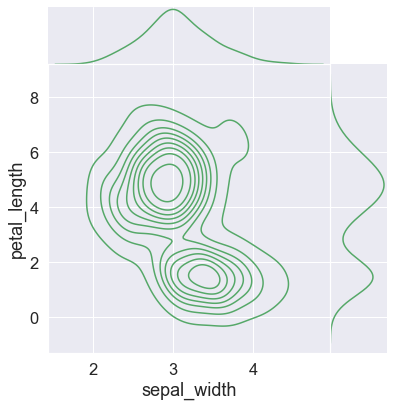

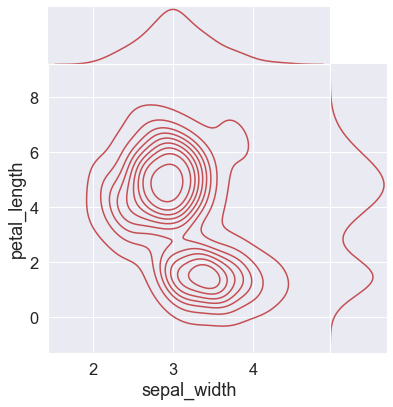

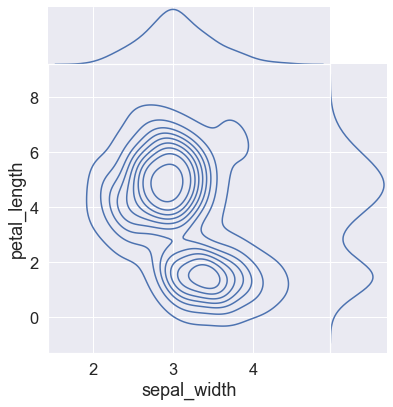

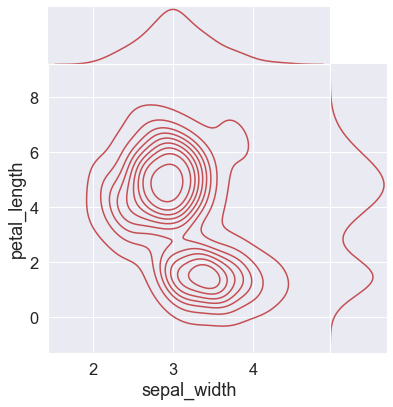

<Figure size 1008x720 with 0 Axes>

In [161]:
iris = sns.load_dataset("iris")
tips = sns.load_dataset("tips")

# An lmplot
#g0 = sns.lmplot(x="total_bill", y="tip", hue="smoker", data=tips, 
#                palette=dict(Yes="g", No="m"))
# A PairGrid
#g1 = sns.PairGrid(iris, hue="species")
#g1.map(plt.scatter, s=5)
# A FacetGrid
#g2 = sns.FacetGrid(tips, col="time",  hue="smoker")
#g2.map(plt.scatter, "total_bill", "tip", edgecolor="w")
# A JointGrid
g_group=[]
color=[["g","r"],["b","r"]]
for i in range(0,2):
    for j in range(0,2):
        print('i:{}-j:{}'.format(i,j))
        g = sns.jointplot("sepal_width", "petal_length", data=iris,
                       kind="kde", space=0, color=color[i][j])
        g_group.append(g)
np_group=np.array(g_group)
np.reshape(np_group,(2,2))
#g3 = sns.jointplot("sepal_width", "petal_length", data=iris,
#                   kind="kde", space=0, color="g")

#g4 = sns.jointplot("sepal_width", "petal_length", data=iris,
#                   kind="kde", space=0, color="r")

#g5 = sns.jointplot("sepal_width", "petal_length", data=iris,
#                   kind="kde", space=0, color="b")



fig = plt.figure(figsize=(14,10))
gs = gridspec.GridSpec(2, 2)

mg0 = SeabornFig2Grid(np_group[0][0], fig, gs[0])
mg1 = SeabornFig2Grid(np_group[1][1], fig, gs[1])
mg2 = SeabornFig2Grid(np_group[1][0], fig, gs[2])
mg3 = SeabornFig2Grid(np_group[1][1], fig, gs[3])

gs.tight_layout(fig)
#gs.update(top=0.7)

plt.show()

[[None, None, None], [None, None, None], [None, None, None], [None, None, None]]
0-0
0-1
0-2
1-0
1-1
1-2
2-0
2-1
2-2
3-0
3-1
3-2
col : 0    
x : 0   y : 1  sp_x : 0  sp_y : 0
dopo k : 1   
x : 0   y : 2  sp_x : 0  sp_y : 1
dopo k : 2   
x : 0   y : 3  sp_x : 0  sp_y : 2
x : 0   y : 4  sp_x : 1  sp_y : 0
col : 1    
dopo k : 1   
x : 1   y : 2  sp_x : 1  sp_y : 1
dopo k : 2   
x : 1   y : 3  sp_x : 1  sp_y : 2
x : 1   y : 4  sp_x : 2  sp_y : 0
col : 2    
dopo k : 1   
x : 2   y : 3  sp_x : 2  sp_y : 1
prima k : 2   
x : 2   y : 4  sp_x : 2  sp_y : 2
col : 3    
x : 3   y : 4  sp_x : 3  sp_y : 0
col : 4    


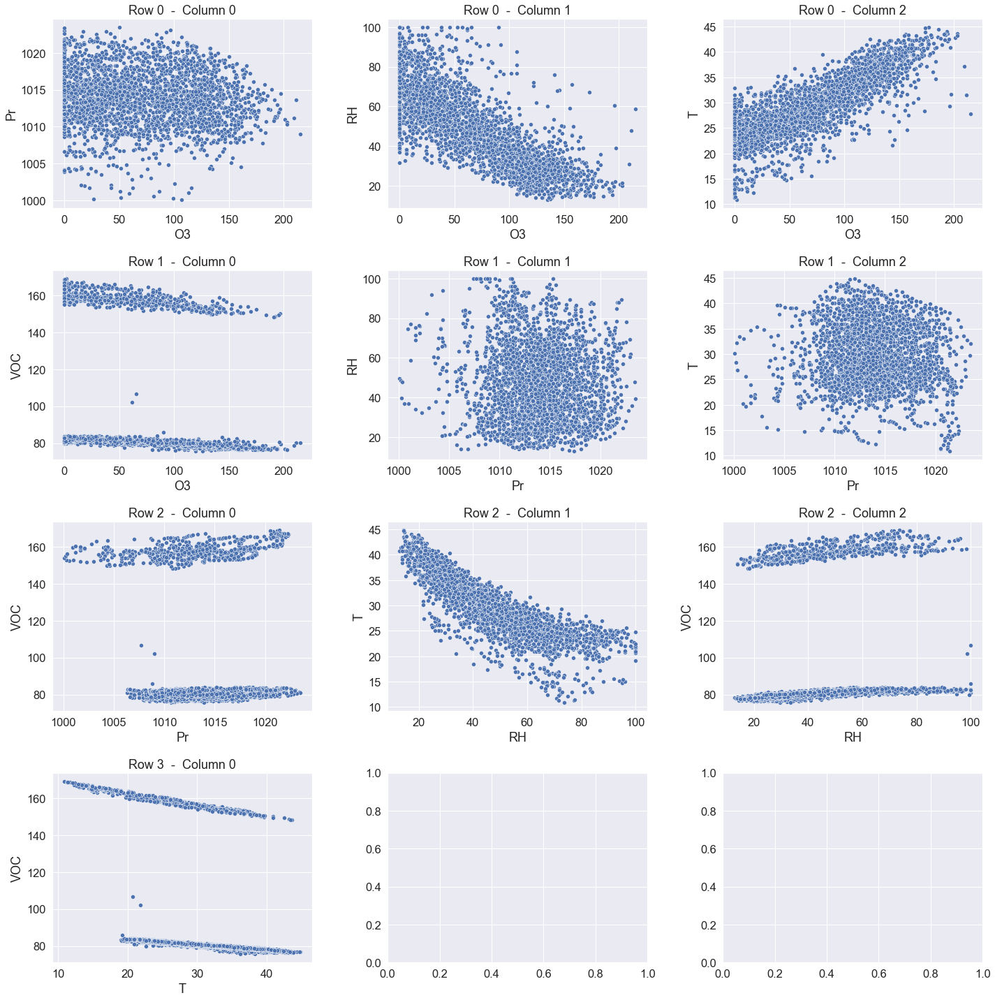

In [75]:
single_figure_plot( data = df_ARGINONE[inquinanti.keys()] ,
                    n  = 5 , 
                    n_subp = 3, 
                    font_scale = 1.5 , 
                    x_size = 20, 
                    y_size = 20)

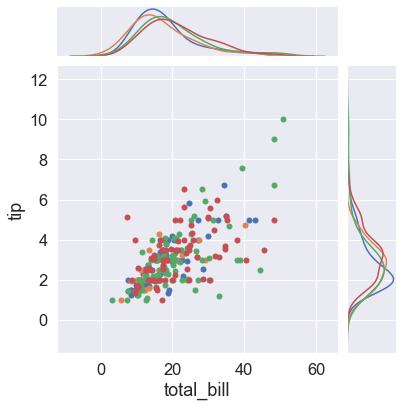

In [162]:
tips = sns.load_dataset("tips")
g = sns.JointGrid("total_bill", "tip", tips)
for day, day_tips in tips.groupby("day"):
    sns.kdeplot(day_tips["total_bill"], ax=g.ax_marg_x, legend=False)
    sns.kdeplot(day_tips["tip"], ax=g.ax_marg_y, vertical=True, legend=False)
    g.ax_joint.plot(day_tips["total_bill"], day_tips["tip"], "o", ms=5)

# Analisi correlazioni tra inquinanti

<AxesSubplot:>

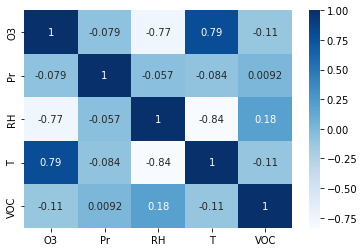

In [5]:
cmap=sns.diverging_palette(5, 250, as_cmap=True)

corr = rilevazioni[inquinanti.keys()].corr()

sns.heatmap(corr, cmap="Blues", annot=True)

In [6]:
fig = px.scatter(data_frame=rilevazioni, x = "O3", y = "T", title="Correlation O3 - T", trendline = "ols", trendline_scope="overall")
fig.update_traces(marker=dict(size=2,
                              line=dict(width=2,
                                        color='blue')), opacity = 0.5,
                  selector=dict(mode='markers'))

In [7]:
fig = px.scatter(data_frame=rilevazioni, x = "O3", y = "RH", title="Correlation O3 - RH", trendline = "ols", trendline_scope="overall")
fig.update_traces(marker=dict(size=2,
                              line=dict(width=2,
                                        color='blue')), opacity = 0.5,
                  selector=dict(mode='markers'))

In [8]:
fig = px.scatter(data_frame=rilevazioni, x = "RH", y = "T", title="Correlation RH - T", trendline = "ols", trendline_scope="overall")
fig.update_traces(marker=dict(size=2,
                              line=dict(width=2,
                                        color='blue')), opacity = 0.5,
                  selector=dict(mode='markers'))

## Trend analys with rolling

In [9]:
def get_rolling_mean(df,location_col,location_param,col,num,center): 
    df_rolling = df.copy() 
    df_rolling = df_rolling.loc[df_rolling[location_col] == location_param].copy() 
    for cols in col: 
        df_rolling[f"Rolling_{cols}"] = df_rolling[cols].rolling(int(num),center=center).mean() 
    return df_rolling

In [10]:
#fig = px.scatter_3d(rolling_df, x ="Rolling_Pr", y="Rolling_O3", z="Rolling_RH", color = "Location", animation_frame="Month_Name")
rolling_df = pd.DataFrame()
for centralina in list(rilevazioni.Location.unique()):
    prova = get_rolling_mean(rilevazioni, "Location", centralina, ["O3", "Pr", "RH", "T", "VOC"],48,False)
    rolling_df = rolling_df.append(prova)
rolling_df = rolling_df.sort_values(by='Data', ascending = False)
for c in rolling_df:
    if 'Rolling' in c:
        title = c.split("_",1)[1]
        fig = px.line(rolling_df, x ="Data", y=c, color = "Location", title = title)
        fig.show()

## Analisys with Map

In [11]:
# geopandas json
data = gpd.read_file("limits_IT_municipalities.geojson")
data = data[data.name == 'Ferrara']

crs={'init':'epsg:4326'}
# creazione dataframe geo partendo da dataframe stazioni
geo_df=gpd.GeoDataFrame(anagrafica_centraline,crs=crs,geometry=gpd.points_from_xy(anagrafica_centraline["longitudine"], anagrafica_centraline["latitudine"]))

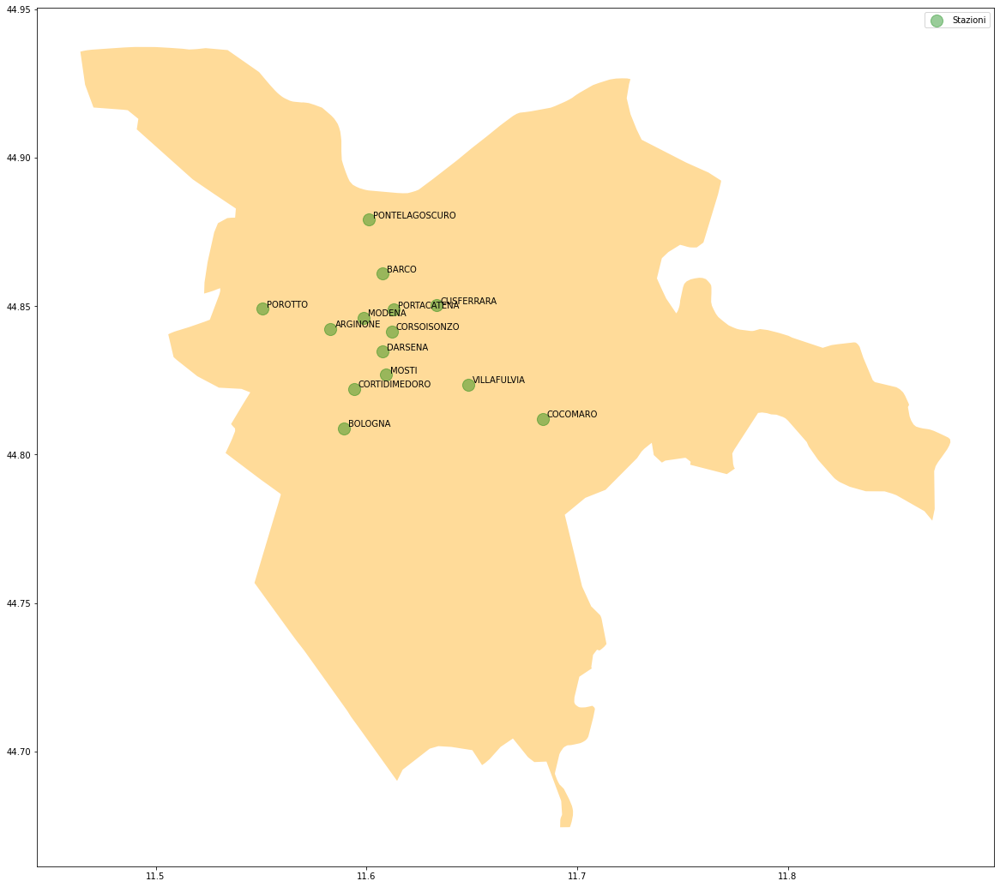

In [12]:
fig, ax = plt.subplots(figsize = (20,20))
data.plot(ax = ax, alpha = 0.4, color = "orange")
geo_df.plot(ax=ax,markersize=200, alpha=0.4,color="green", label = "Stazioni")
for x, y, label in zip(geo_df.longitudine, geo_df.latitudine, geo_df.Location):
    ax.annotate(label, xy=(x, y), xytext=(5, 5), textcoords="offset points", va = "center")
plt.legend()
plt.show()

In [13]:
import geoplot
import geoplot.crs as gcrs

In [14]:
rilevazioni_copy = rilevazioni.copy()
def std(x): 
    return np.std(x)
df_stddev = rilevazioni_copy.groupby("Location").agg([std])[['O3', 'Pr', 'T', 'VOC', 'RH']].reset_index()
df_stddev = df_stddev.droplevel(1, axis = 1)
df_stddev

,Location,O3,Pr,T,VOC,RH
0,ARGINONE,50.012123,3.725538,6.158405,31.606725,19.514486
1,BARCO,54.620721,3.753086,6.166282,44.704531,18.751985
2,BOLOGNA,45.993734,3.744462,5.897936,24.421701,17.291302
3,COCOMARO,47.855642,3.750624,5.837015,120.929677,17.811632
4,CORSOISONZO,47.362499,3.739267,5.070438,108.772447,17.311625
5,CUSFERRARA,57.183544,3.764254,6.680610,36.671022,20.284407
6,MODENA,41.326824,3.731096,5.933930,151.933861,16.930992
7,MOSTI,42.603470,3.731964,5.891939,109.633057,15.524533
8,PONTELAGOSCURO,51.377294,3.724658,6.208419,44.691248,17.987143
9,POROTTO,50.025880,3.711162,5.453408,447.399862,14.917105


In [15]:
geo_df = pd.merge(geo_df, df_stddev, on = 'Location')

In [16]:
geo_df

,Location,indirizzo,latitudine,longitudine,geometry,O3,Pr,T,VOC,RH
0,BARCO,"Via Rino Maragno 46, Ferrara",44.860988,11.607838,POINT (11.60784 44.86099),54.620721,3.753086,6.166282,44.704531,18.751985
1,MODENA,"Via Guglielmo Marconi 19, Ferrara",44.846107,11.598717,POINT (11.59872 44.84611),41.326824,3.731096,5.933930,151.933861,16.930992
2,PORTACATENA,"Piazzale dei Giochi 67, Ferrara",44.848840,11.612900,POINT (11.61290 44.84884),47.835535,3.742231,5.890401,2.237599,17.672927
3,ARGINONE,"Via Arginone 206 B, Ferrara",44.842270,11.583010,POINT (11.58301 44.84227),50.012123,3.725538,6.158405,31.606725,19.514486
4,CORSOISONZO,"Corso Isonzo 1, Ferrara",44.841510,11.612110,POINT (11.61211 44.84151),47.362499,3.739267,5.070438,108.772447,17.311625
5,MOSTI,"Via Gaetano Recchi 5H, Ferrara",44.826850,11.609195,POINT (11.60919 44.82685),42.603470,3.731964,5.891939,109.633057,15.524533
6,BOLOGNA,"Via Bologna 549, Ferrara",44.808802,11.589487,POINT (11.58949 44.80880),45.993734,3.744462,5.897936,24.421701,17.291302
7,COCOMARO,"Via Comacchio 687, Ferrara",44.812002,11.683750,POINT (11.68375 44.81200),47.855642,3.750624,5.837015,120.929677,17.811632
8,VILLAFULVIA,"Via delle Mandriole 29, Ferrara",44.823650,11.648440,POINT (11.64844 44.82365),57.389373,3.738196,5.782480,38.169931,17.699769
9,CUSFERRARA,"Via Gramicia 70, Ferrara",44.850239,11.633109,POINT (11.63311 44.85024),57.183544,3.764254,6.680610,36.671022,20.284407
